# Script to aquire and pre-process OSM data to an Xarray cube

In [ ]:
## Import libraries
# system
import os
import sys
import time
import calendar
import io
import requests
import multiprocessing as mp
from concurrent.futures import ThreadPoolExecutor, as_completed
import threading
from dotenv import load_dotenv


# aws bucket access
import boto3

# data manipulation
import json
import random
from PIL import Image
from io import BytesIO
import numpy as np
import pandas as pd
import geopandas as gpd
import osmnx as ox
import rasterio as rio
import xarray as xr
import rioxarray as rxr
from rasterio.transform import from_bounds
from rasterio.features import geometry_mask, rasterize
from pyproj import Transformer, CRS
from shapely.geometry import box, shape, Polygon
#from samgeo import tms_to_geotiff

# visualization
from rasterio.plot import show
import leafmap
import folium
from ipyleaflet import Map, WMSLayer, basemaps, TileLayer, DrawControl, FullScreenControl, LayersControl, MeasureControl, SplitMapControl, WidgetControl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib as mpl
import seaborn as sns
from tqdm import tqdm

repo_name = 'masterthesis_genai_spatialplan'
if not repo_name in os.getcwd():
    os.chdir(repo_name)

p=os.popen('git rev-parse --show-toplevel')
repo_dir = p.read().strip()
p.close()

#seaborn cmap
rocket=sns.color_palette("rocket", as_cmap=True)
mako=sns.color_palette("mako", as_cmap=True)

### Get the boundaries of Leipzig

In [ ]:
# Define bbox for entire Leipzig
xmin, ymin = 12.2714, 51.2705  # Southwest corner
xmax, ymax = 12.5019, 51.4174  # Northeast corner

# Create bbox polygon
bbox = box(xmin, ymin, xmax, ymax)

# Create GeoDataFrame
bbox_gdf = gpd.GeoDataFrame(geometry=[bbox], crs="EPSG:4326")

bbox_gdf.explore()

Create a grid for multithreading

In [3]:
# xmin, ymin, xmax, ymax = gdf.total_bounds
length = 0.005
width = 0.005

cols = list(np.arange(xmin, xmax + width, width))
rows = list(np.arange(ymin, ymax +length, length))

polygons = []
for x in cols[:-1]:
    for y in rows[:-1]:
        polygons.append(Polygon([
            (x, y), (x+width, y), (x+width, y+length), (x, y+length)
        ]))
grid = gpd.GeoDataFrame(geometry=polygons, crs="EPSG:4326")
# grid =gpd.overlay(grid, gdf, how='intersection')
grid.explore()

## Request OpenStreetMap Data

First try with the landuse

In [ ]:
ox.settings.use_cache = True

bbox = (xmin, ymin, xmax, ymax)

# Define tags query
tags = {"landuse": True}  # True gets all landuse values

# Extract features
landuse_gdf = ox.features_from_bbox(
    (bbox[0],  # left
    bbox[1],  # bottom
    bbox[2],  # right
    bbox[3]),  # top
    tags=tags
)

# Clean and display
landuse_gdf = landuse_gdf[landuse_gdf.geometry.is_valid]
print(f"Number of features: {len(landuse_gdf)}")
print("\nLanduse types:")
print(landuse_gdf['landuse'].value_counts())

Number of features: 12989

Landuse types:
landuse
grass                      7916
residential                1226
allotments                  534
meadow                      502
forest                      437
farmland                    341
commercial                  329
construction                229
garages                     216
industrial                  214
brownfield                  198
railway                     187
retail                      165
village_green               100
flowerbed                    81
basin                        55
cemetery                     50
farmyard                     44
recreation_ground            34
greenfield                   33
orchard                      20
greenhouse_horticulture      17
religious                    14
landfill                     10
plant_nursery                 8
education                     3
reservoir                     3
quarry                        3
greenland                     2
military              

Explore the requested land use

In [ ]:
landuse_gdf[0:2000].explore()

### Request data for a sample area

In [8]:
#get everythign for a smaller area first

# Define bbox for urban area in Leipzig 
xmin, ymin = 12.3735, 51.324  # Southwest corner
xmax, ymax = 12.3935, 51.3321  # Northeast corner

# Create bbox polygon
bbox = (xmin, ymin, xmax, ymax)

# get streets, water, parks and buildings, landuse
tags = {
    "building": True,
    "waterway": True,
    "natural": True, #["water", "wood", "grassland"],
    "highway": True,
    "landuse": True,
    "leisure": ["park", "garden"],
    "place": ["square"],
    "amenity": ["fountain"]
}

# Extract features
leipzig_urban_gdf = ox.features_from_bbox(
    bbox=bbox,
    tags=tags
)

# Clean and display
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]
print(f"Number of features: {len(leipzig_urban_gdf)}")
print("\nFeature types:")
print(leipzig_urban_gdf['geometry'].type.value_counts())

Number of features: 2807

Feature types:
LineString      1389
Polygon          901
Point            514
MultiPolygon       3
Name: count, dtype: int64


In [9]:
leipzig_urban_gdf.explore()

### Rasterize the data

In [10]:
# filter out only buildings
buildings_gdf = leipzig_urban_gdf[leipzig_urban_gdf["building"].notnull()]
geom = [shapes for shapes in buildings_gdf.geometry]
transform = from_bounds(xmin, ymin, xmax, ymax, 1024, 1024)

There is two different approaches with rio, they are equally fast:

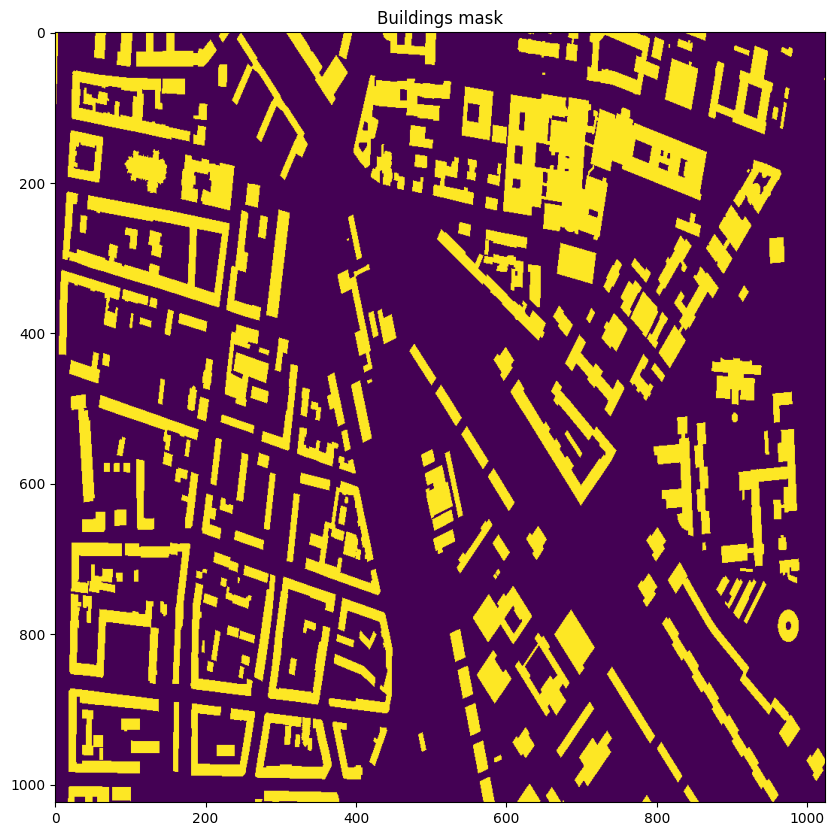

In [11]:
# Create raster
mask = geometry_mask(buildings_gdf.geometry, transform=transform, invert=True, out_shape=(1024, 1024))

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(mask, ax=ax)
ax.set_title("Buildings mask")
plt.show()

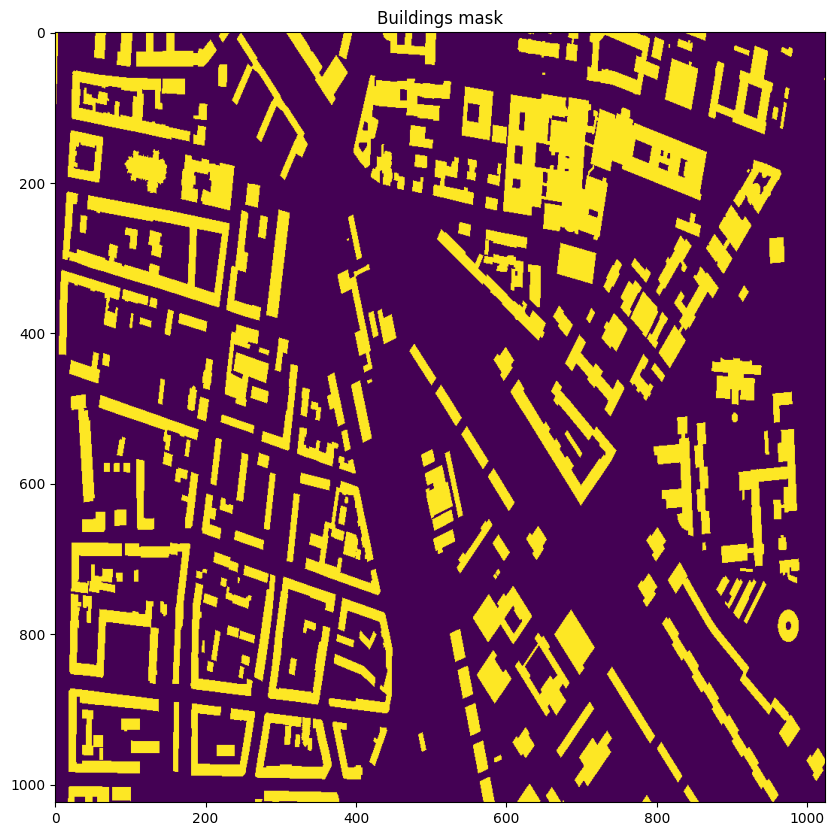

In [12]:
rasterized = rasterize(geom,
    out_shape = (1024, 1024),
    fill = 0,
    out = None,
    transform = transform,
    all_touched = False,
    default_value = 1,
    dtype = None)

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(rasterized, ax=ax)
ax.set_title("Buildings mask")
plt.show()